In [1]:
import pandas as pd
import numpy as np
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_squared_error, classification_report,accuracy_score,precision_score,recall_score,f1_score
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import plotly.express as pe
from sklearn import tree
import seaborn as sns
plt.rcParams['figure.figsize'] = (10,5)
plt.rcParams['figure.dpi'] = 1000
sns.set_theme(style='darkgrid', palette='rainbow')
import warnings
warnings.filterwarnings('ignore')

In [2]:
df = pd.read_csv('https://raw.githubusercontent.com/PrathameshR10/Assignments/main/Folder/glass%20a14.csv')
df

,RI,Na,Mg,Al,Si,K,Ca,Ba,Fe,Type
0,1.52101,13.64,4.49,1.10,71.78,0.06,8.75,0.0,0.0,1.0
1,1.51761,13.89,3.60,1.36,72.73,0.48,7.83,0.0,0.0,1.0
2,1.51618,13.53,3.55,1.54,72.99,0.39,7.78,0.0,0.0,1.0
3,1.51766,13.21,3.69,1.29,72.61,0.57,8.22,0.0,0.0,1.0
4,1.51742,13.27,3.62,1.24,73.08,0.55,8.07,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...
994,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
995,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
996,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
997,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Missing Values

In [3]:
df.isna().sum()

RI      785
Na      785
Mg      785
Al      785
Si      785
K       785
Ca      785
Ba      785
Fe      785
Type    785
dtype: int64

In [4]:
df.dropna(inplace=True)

In [5]:
df.isna().sum()

RI      0
Na      0
Mg      0
Al      0
Si      0
K       0
Ca      0
Ba      0
Fe      0
Type    0
dtype: int64

### Duplicated Values

In [6]:
df.duplicated().sum()

1

In [7]:
df[df.duplicated(keep=False)]

,RI,Na,Mg,Al,Si,K,Ca,Ba,Fe,Type
38,1.52213,14.21,3.82,0.47,71.77,0.11,9.57,0.0,0.0,1.0
39,1.52213,14.21,3.82,0.47,71.77,0.11,9.57,0.0,0.0,1.0


In [8]:
df.drop_duplicates(inplace=True)

In [9]:
df.duplicated().sum()

0

### Descriptive Stats

In [10]:
df.describe()

,RI,Na,Mg,Al,Si,K,Ca,Ba,Fe,Type
count,213.000000,213.000000,213.000000,213.000000,213.000000,213.000000,213.000000,213.000000,213.000000,213.000000
mean,1.518348,13.404085,2.679202,1.449484,72.655070,0.498873,8.954085,0.175869,0.057277,2.788732
std,0.003033,0.816662,1.443691,0.495925,0.773998,0.653185,1.425882,0.498245,0.097589,2.105130
min,1.511150,10.730000,0.000000,0.290000,69.810000,0.000000,5.430000,0.000000,0.000000,1.000000
25%,1.516520,12.900000,2.090000,1.190000,72.280000,0.130000,8.240000,0.000000,0.000000,1.000000
50%,1.517680,13.300000,3.480000,1.360000,72.790000,0.560000,8.600000,0.000000,0.000000,2.000000
75%,1.519150,13.810000,3.600000,1.630000,73.090000,0.610000,9.150000,0.000000,0.100000,3.000000
max,1.533930,17.380000,4.490000,3.500000,75.410000,6.210000,16.190000,3.150000,0.510000,7.000000


In [11]:
df.info()           # No Data Inconsistencies

<class 'pandas.core.frame.DataFrame'>
Int64Index: 213 entries, 0 to 213
Data columns (total 10 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   RI      213 non-null    float64
 1   Na      213 non-null    float64
 2   Mg      213 non-null    float64
 3   Al      213 non-null    float64
 4   Si      213 non-null    float64
 5   K       213 non-null    float64
 6   Ca      213 non-null    float64
 7   Ba      213 non-null    float64
 8   Fe      213 non-null    float64
 9   Type    213 non-null    float64
dtypes: float64(10)
memory usage: 18.3 KB


### Data Visualisation

In [12]:
pe.box(df,orientation='h')

<Axes: >

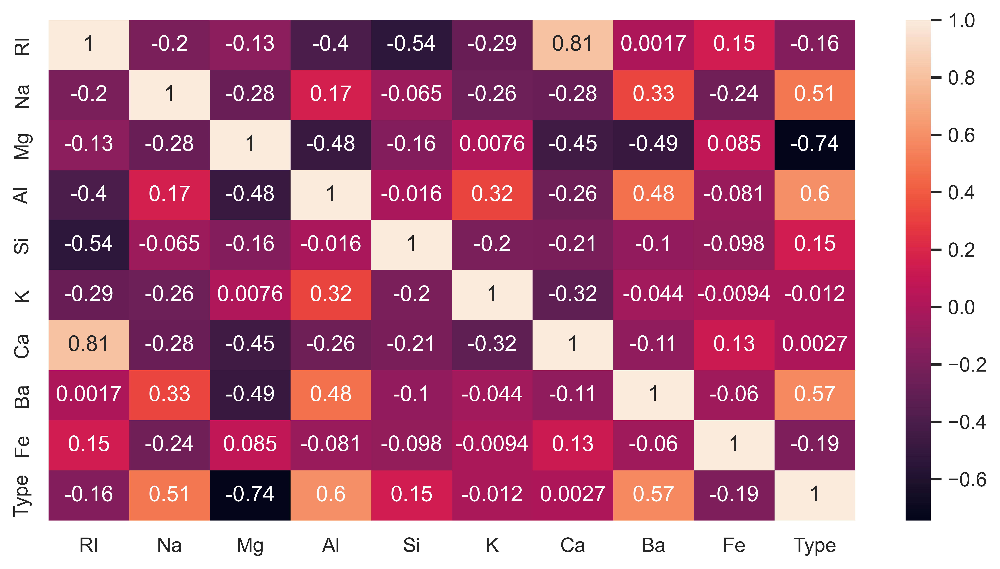

In [13]:
sns.heatmap(df.corr(),annot=True)

<Axes: xlabel='RI', ylabel='Ca'>

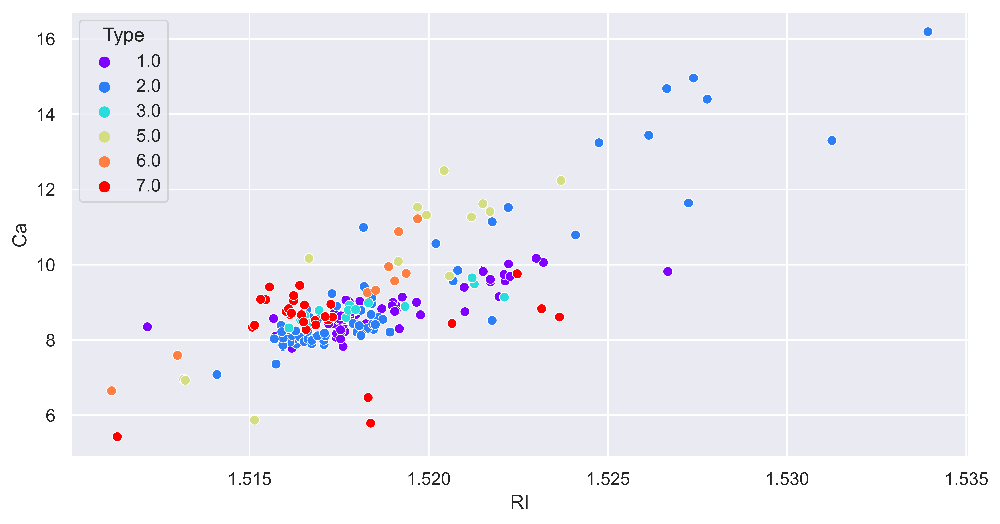

In [14]:
sns.scatterplot(x = 'RI', y = 'Ca',data =df,hue='Type',palette='rainbow')

<Axes: ylabel='Type'>

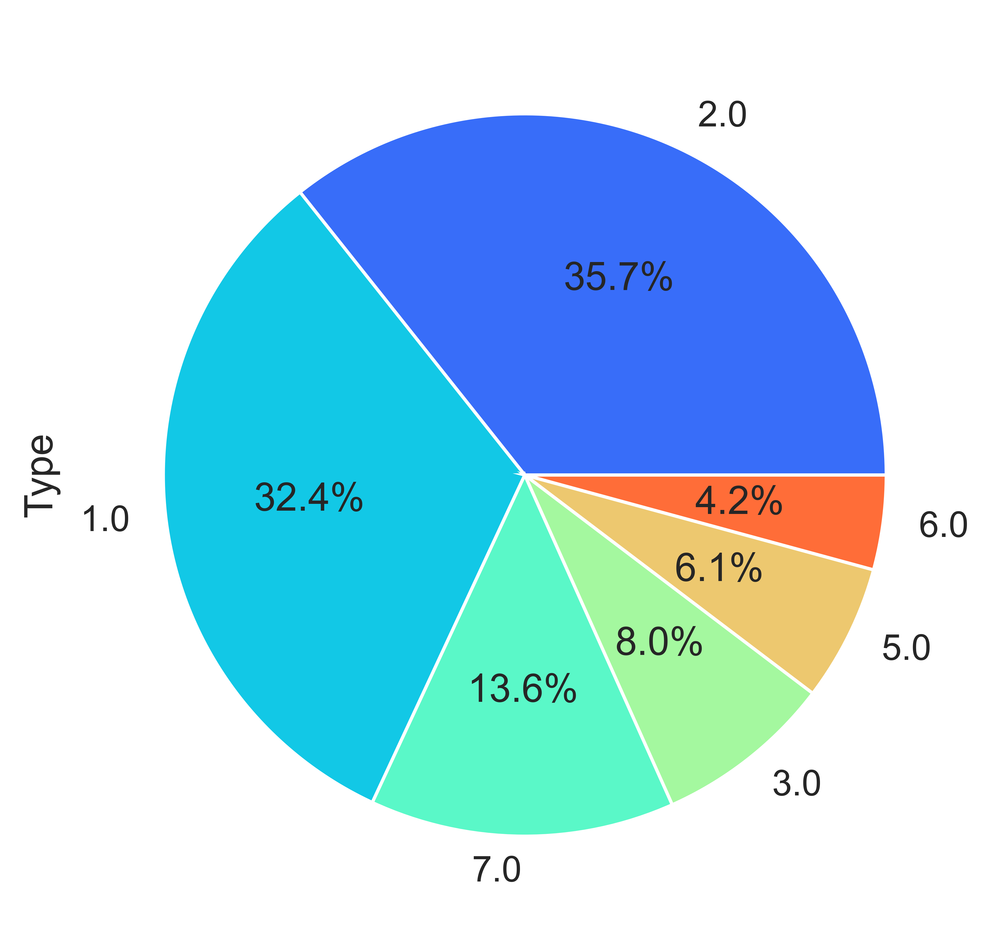

In [15]:
round(df['Type'].value_counts()/df.shape[0]*100,2).plot.pie(autopct="%1.1f%%")

In [16]:
sns.pairplot(df.drop(columns='Type'))

### Outliers

In [17]:
df.skew()

RI      1.648017
Na      0.465699
Mg     -1.146096
Al      0.938402
Si     -0.744646
K       6.545429
Ca      2.050752
Ba      3.406749
Fe      1.747173
Type    1.108861
dtype: float64

In [18]:
df.columns

Index(['RI', 'Na', 'Mg', 'Al', 'Si', 'K', 'Ca', 'Ba', 'Fe', 'Type'], dtype='object')

In [19]:
def outlier_capping(data, columns):
    Q1 = df[columns].quantile(0.25)
    Q3 = df[columns].quantile(0.75)
    IQR = Q3 -Q1
    
    lower_cap = Q1 - 1.5 * IQR
    upper_cap = Q3 + 1.5 * IQR
    
    df[columns] = df[columns].clip(lower=lower_cap, upper=upper_cap, axis = 1)
    return df

cap_columns = ['RI', 'Na', 'Mg', 'Al', 'Si', 'K', 'Ca', 'Ba', 'Fe']
cap_df = outlier_capping(df, cap_columns)

In [20]:
pe.box(df.drop(columns='Type'),orientation='h')

In [21]:
df.skew()

RI      0.522499
Na      0.234377
Mg     -1.146096
Al      0.226531
Si     -0.501819
K       0.332414
Ca      0.463722
Ba      0.000000
Fe      1.307160
Type    1.108861
dtype: float64

In [22]:
df['Fe'] = np.sqrt(df['Fe'])

In [23]:
df.skew()

RI      0.522499
Na      0.234377
Mg     -1.146096
Al      0.226531
Si     -0.501819
K       0.332414
Ca      0.463722
Ba      0.000000
Fe      0.951839
Type    1.108861
dtype: float64

In [24]:
numerical_features = ['RI', 'Na', 'Mg', 'Al', 'Si', 'K', 'Ca', 'Ba', 'Fe']

plt.figure(figsize=(16, 12))

for i, feature in enumerate(numerical_features):
    plt.subplot(5, 4, 2*i+1)
    sns.histplot(df[feature], kde=True)
    plt.title(f'Histogram of {feature}')

    plt.subplot(5, 4, 2*i+2)
    sns.boxplot(x=df[feature])
    plt.title(f'Boxplot of {feature}')

plt.tight_layout()
plt.show()

In [25]:
df['Fe'].value_counts()          # Highly Skewed

0.000000    143
0.500000     13
0.489898      7
0.412311      7
0.300000      6
0.316228      5
0.331662      4
0.374166      3
0.469042      3
0.400000      3
0.264575      3
0.346410      3
0.435890      2
0.387298      2
0.282843      2
0.244949      1
0.173205      1
0.447214      1
0.458258      1
0.424264      1
0.223607      1
0.100000      1
Name: Fe, dtype: int64

In [26]:
df['Ba'].unique()

array([0.])

In [27]:
df.drop(columns=['Ba','Fe'],inplace=True)

In [28]:
df['Type'].unique()

array([1., 2., 3., 5., 6., 7.])

In [29]:
df['Type'].replace([1., 2., 3., 5., 6., 7.],[' bw_float_processed','bw_non_float_processed','vw_float_processed','containers','tableware','headlamps'],inplace=True)

<Axes: xlabel='count', ylabel='Type'>

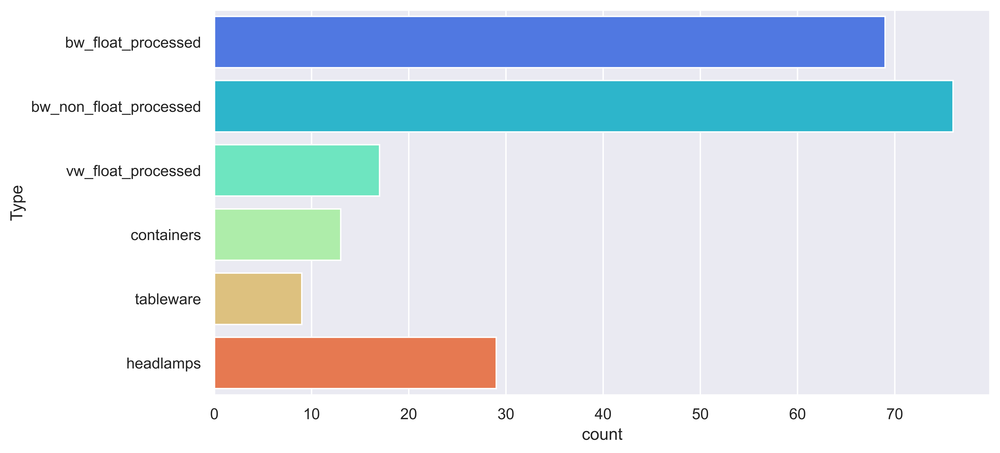

In [30]:
sns.countplot(y = df['Type'])

In [31]:
df

,RI,Na,Mg,Al,Si,K,Ca,Type
0,1.52101,13.64,4.49,1.10,71.78,0.06,8.75,bw_float_processed
1,1.51761,13.89,3.60,1.36,72.73,0.48,7.83,bw_float_processed
2,1.51618,13.53,3.55,1.54,72.99,0.39,7.78,bw_float_processed
3,1.51766,13.21,3.69,1.29,72.61,0.57,8.22,bw_float_processed
4,1.51742,13.27,3.62,1.24,73.08,0.55,8.07,bw_float_processed
...,...,...,...,...,...,...,...,...
209,1.51623,14.14,0.00,2.29,72.61,0.08,9.18,headlamps
210,1.51685,14.92,0.00,1.99,73.06,0.00,8.40,headlamps
211,1.52065,14.36,0.00,2.02,73.42,0.00,8.44,headlamps
212,1.51651,14.38,0.00,1.94,73.61,0.00,8.48,headlamps


### Standardization

In [32]:
x1 = df.drop(columns='Type')

In [33]:
sc = StandardScaler()
data = sc.fit_transform(x1)
dfs = pd.DataFrame(data,columns=x1.columns)
dfs

,RI,Na,Mg,Al,Si,K,Ca
0,1.216093,0.322680,1.257238,-0.773927,-1.361078,-1.253536,-0.044419
1,-0.227207,0.660556,0.639311,-0.154741,0.086641,0.124799,-1.115733
2,-0.834242,0.174014,0.604596,0.273927,0.482859,-0.170559,-1.173956
3,-0.205982,-0.258467,0.701798,-0.321445,-0.096228,0.420156,-0.661589
4,-0.307862,-0.177377,0.653197,-0.440519,0.620012,0.354521,-0.836260
...,...,...,...,...,...,...,...
208,-0.813017,0.998432,-1.860172,2.060042,-0.096228,-1.187901,0.456303
209,-0.549827,2.052606,-1.860172,1.345596,0.589533,-1.450441,-0.451984
210,1.063273,1.295764,-1.860172,1.417041,1.138143,-1.450441,-0.405405
211,-0.694157,1.322794,-1.860172,1.226522,1.427687,-1.450441,-0.358827


### Model Building

In [34]:
x = dfs
y = df['Type']

In [35]:
xtrain,xtest,ytrain,ytest = train_test_split(x,y,test_size=0.2, random_state=42)

In [36]:
rfc = RandomForestClassifier(random_state=1)

In [37]:
rfc.fit(xtrain,ytrain)

RandomForestClassifier(random_state=1)

In [38]:
y_pred = rfc.predict(xtest)

In [39]:
print(classification_report(ytest,y_pred))

                        precision    recall  f1-score   support

    bw_float_processed       0.91      1.00      0.95        10
bw_non_float_processed       0.78      0.93      0.85        15
            containers       1.00      1.00      1.00         3
             headlamps       1.00      0.78      0.88         9
             tableware       1.00      0.67      0.80         3
    vw_float_processed       1.00      0.67      0.80         3

              accuracy                           0.88        43
             macro avg       0.95      0.84      0.88        43
          weighted avg       0.90      0.88      0.88        43



### Summary

In [40]:
accuracy = accuracy_score(ytest, y_pred)
precision = precision_score(ytest, y_pred, average='weighted')
recall = recall_score(ytest, y_pred, average='weighted')
f1 = f1_score(ytest, y_pred, average='weighted')

print(f'Accuracy: {accuracy}')
print(f'Precision: {precision}')
print(f'Recall: {recall}')
print(f'F1 Score: {f1}')

Accuracy: 0.8837209302325582
Precision: 0.9013389711064129
Recall: 0.8837209302325582
F1 Score: 0.8820019128158663


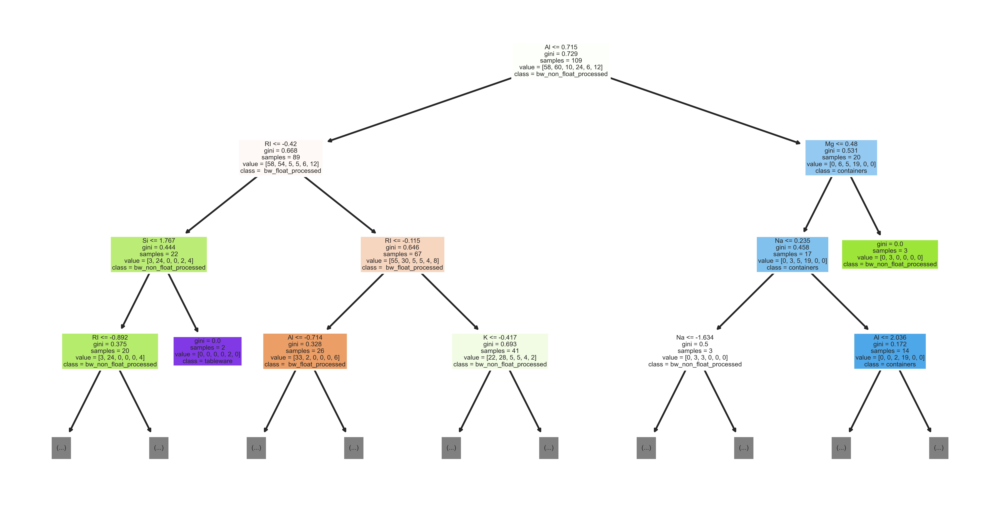

In [41]:
tree.plot_tree(rfc.estimators_[0], feature_names=list(x.columns),
               class_names= list(df['Type'].unique()),
               filled=True , max_depth=3)
plt.show()

In [42]:
from sklearn.ensemble import BaggingClassifier, GradientBoostingClassifier

### Bagging

In [43]:
bagging = BaggingClassifier(base_estimator=rfc, n_estimators=100, random_state=1)
bagging.fit(xtrain, ytrain)
y_pred_bagging = bagging.predict(xtest)

accuracy_ba = accuracy_score(ytest, y_pred_bagging)
precision_ba = precision_score(ytest, y_pred_bagging, average='weighted')
recall_ba = recall_score(ytest, y_pred_bagging, average='weighted')
f1_ba = f1_score(ytest, y_pred_bagging, average='weighted')

print(f'Accuracy: {accuracy_ba}')
print(f'Precision: {precision_ba}')
print(f'Recall: {recall_ba}')
print(f'F1 Score: {f1_ba}')

Accuracy: 0.813953488372093
Precision: 0.8413621262458473
Recall: 0.813953488372093
F1 Score: 0.8130016802230112


### Boosting

In [44]:
gb = GradientBoostingClassifier(n_estimators=100, random_state=1)
gb.fit(xtrain, ytrain)
y_pred_gb = gb.predict(xtest)

accuracy_bg = accuracy_score(ytest, y_pred_gb)
precision_bg = precision_score(ytest, y_pred_gb, average='weighted')
recall_bg = recall_score(ytest, y_pred_gb, average='weighted')
f1_bg = f1_score(ytest, y_pred_gb, average='weighted')

print(f'Accuracy: {accuracy_bg}')
print(f'Precision: {precision_bg}')
print(f'Recall: {recall_bg}')
print(f'F1 Score: {f1_bg}')

Accuracy: 0.8372093023255814
Precision: 0.8685918732430361
Recall: 0.8372093023255814
F1 Score: 0.8380103552874726


### Comparison

In [45]:
results = {
    'Model': ['Bagging', 'Gradient Boosting'],
    'Accuracy': [accuracy_ba,accuracy_bg], 
    'Precision': [precision_ba,precision_bg], 
    'Recall': [recall_ba,recall_bg],   
    'F1 Score': [f1_ba,f1_bg] 
}

In [46]:
results_df = pd.DataFrame(results)

In [47]:
results_df

,Model,Accuracy,Precision,Recall,F1 Score
0,Bagging,0.813953,0.841362,0.813953,0.813002
1,Gradient Boosting,0.837209,0.868592,0.837209,0.838010


### Additional Questions